# Cardiovasculaire risks

## Libraries

In [1]:

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import warnings
warnings.simplefilter('ignore')

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os#Walking through directores

import plotly.graph_objects as go # Generate Graphs
from plotly.subplots import make_subplots #To Create Subplots

from sklearn import decomposition #pca
from sklearn.preprocessing import StandardScaler # Standardization ((X - X_mean)/X_std)

from sklearn.neighbors import KNeighborsClassifier #KNN Model
from sklearn.ensemble import RandomForestClassifier #RandomForest Model
from sklearn.linear_model import LogisticRegression #Logistic Model

from sklearn.model_selection import train_test_split # Splitting into train and test

from sklearn.model_selection import GridSearchCV# Hyperparameter Tuning
from sklearn.model_selection import cross_val_score#cross validation score

from sklearn.metrics import classification_report # text report showing the main classification metrics
from sklearn.metrics import confusion_matrix #to get confusion_matirx 

pd.set_option('display.max_columns', None)#Setting Max Columns Display to Max inorder to get glance of all features in dataframe

## Dataset

In [3]:

df = pd.read_csv('cardio_train.csv', sep = ';')

In [4]:
df.head()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,4,17474,1,156,56.0,100,60,1,1,0,0,0,0


In [6]:
print("Number of rows: %d" % df.shape[0])
print("Number of columns: %d" % df.shape[1])

Number of rows: 70000
Number of columns: 13


In [7]:
# Check for missing values
print(df.isnull().sum())

id             0
age            0
gender         0
height         0
weight         0
ap_hi          0
ap_lo          0
cholesterol    0
gluc           0
smoke          0
alco           0
active         0
cardio         0
dtype: int64


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           70000 non-null  int64  
 1   age          70000 non-null  int64  
 2   gender       70000 non-null  int64  
 3   height       70000 non-null  int64  
 4   weight       70000 non-null  float64
 5   ap_hi        70000 non-null  int64  
 6   ap_lo        70000 non-null  int64  
 7   cholesterol  70000 non-null  int64  
 8   gluc         70000 non-null  int64  
 9   smoke        70000 non-null  int64  
 10  alco         70000 non-null  int64  
 11  active       70000 non-null  int64  
 12  cardio       70000 non-null  int64  
dtypes: float64(1), int64(12)
memory usage: 6.9 MB


Since we have total datapoints as 70000, we can even conclude from above data that we have no Null Values

### Droping ID column

In [9]:
df.drop(['id'], axis=1, inplace=True)

In [10]:
df.head()

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,17474,1,156,56.0,100,60,1,1,0,0,0,0


In [11]:
duplicate_sum = df.duplicated().sum()
if duplicate_sum:
    print('Duplicates Rows in Dataset are : {}'.format(duplicate_sum))
else:
    print('Dataset contains no Duplicate Values')

Duplicates Rows in Dataset are : 24


In [12]:
Continuous_features = [feature for feature in df.columns if len(df[feature].unique())>25]
print('Continuous Values are : {}'.format(Continuous_features))

Continuous Values are : ['age', 'height', 'weight', 'ap_hi', 'ap_lo']


In [13]:
df[Continuous_features].head()

,age,height,weight,ap_hi,ap_lo
0,18393,168,62.0,110,80
1,20228,156,85.0,140,90
2,18857,165,64.0,130,70
3,17623,169,82.0,150,100
4,17474,156,56.0,100,60


In [15]:
df[Continuous_features].describe()

,age,height,weight,ap_hi,ap_lo
count,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000
mean,19468.865814,164.359229,74.205690,128.817286,96.630414
std,2467.251667,8.210126,14.395757,154.011419,188.472530
min,10798.000000,55.000000,10.000000,-150.000000,-70.000000
25%,17664.000000,159.000000,65.000000,120.000000,80.000000
50%,19703.000000,165.000000,72.000000,120.000000,80.000000
75%,21327.000000,170.000000,82.000000,140.000000,90.000000
max,23713.000000,250.000000,200.000000,16020.000000,11000.000000


### Box Plot



In [16]:
fig = go.Figure()

fig.add_trace(go.Box(x=df['height'], name = 'Height', boxpoints='outliers',))
fig.add_trace(go.Box(x=df['weight'], name = 'Weight', boxpoints='outliers',))

fig.update_layout(title_text="Box Plot for Weight and Height with Outliers")
fig.show()

We can observe lot's of outliers ( Points below Lower Fence and Above Upper Fence )
To explain more about Outliers and result of this Box Plot, I'll use IQR Interquartile Range

In [17]:
fig = make_subplots(rows=1, cols=2, subplot_titles=("Height Distribution", "Weight Distribution"))

trace0 = go.Histogram(x=df['height'], name = 'Height')
trace1 = go.Histogram(x=df['weight'], name = 'Weight')


fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)

fig.update_xaxes(title_text="Height", row=1, col=1)
fig.update_yaxes(title_text="Total Count", row=1, col=1)

fig.update_xaxes(title_text="Weight", row=1, col=2)
fig.update_yaxes(title_text="Total Count", row=1, col=2)

fig.update_layout(title_text="Histograph", height=700)


fig.show()

In [18]:
def outliers(df_out, drop = False):
    for each_feature in df_out.columns:
        feature_data = df_out[each_feature]
        Q1 = np.percentile(feature_data, 25.) # 25th percentile of the data of the given feature
        Q3 = np.percentile(feature_data, 75.) # 75th percentile of the data of the given feature
        IQR = Q3-Q1 #Interquartile Range
        outlier_step = IQR * 1.5 #That's we were talking about above
        outliers = feature_data[~((feature_data >= Q1 - outlier_step) & (feature_data <= Q3 + outlier_step))].index.tolist()  
        print('For the feature {}, No of Outliers is {}'.format(each_feature, len(outliers)))
outliers(df[['height', 'weight']])

For the feature height, No of Outliers is 519
For the feature weight, No of Outliers is 1819


Well That's good quality of data that we'll gonna lose. So, Rather than of using this problem Let's explore other techniques to hangle this problem

One way is Transforming variables.
Transforming variables can also eliminate outliers. Natural log of a value reduces the variation caused by extreme values



In [24]:
outline_free_df = df.copy()
outline_free_df[['height', 'weight']] = np.log(outline_free_df[['height', 'weight']])
outliers(outline_free_df[['height', 'weight']])

For the feature height, No of Outliers is 484
For the feature weight, No of Outliers is 1174


In [25]:
outline_free_df = outline_free_df[(outline_free_df['weight'] > outline_free_df['weight'].quantile(0.005)) & (outline_free_df['weight'] < outline_free_df['weight'].quantile(0.995))]
outline_free_df = outline_free_df[(outline_free_df['height'] > outline_free_df['height'].quantile(0.005)) & (outline_free_df['height'] < outline_free_df['height'].quantile(0.995))]
outliers(outline_free_df[['height', 'weight']])

For the feature height, No of Outliers is 0
For the feature weight, No of Outliers is 349


In [26]:
print('Handling outliners cost us {} datapoints'.format(len(df)-len(outline_free_df)))

Handling outliners cost us 1630 datapoints


We finally get rid of all the outliers from height and pretty good amount from weight.
Maintaining the momentum why not let's get rid of ap_hi and ap_lo values that are negative

In [27]:
outline_free_df = outline_free_df[outline_free_df['ap_lo']>=0]
outline_free_df = outline_free_df[outline_free_df['ap_hi']>=0]

As we researched, Substracting Diastolic blood pressure from Systolic blood pressure gives Pulse Pressure that can't be negative
Therefore, ap_hi > ap_lo

In [28]:
print('There are total {} observations where ap_hi < ap_lo'.format(len(outline_free_df[outline_free_df['ap_hi'] < outline_free_df['ap_lo']])))

There are total 1182 observations where ap_hi < ap_lo


In [29]:
cleaned_data = outline_free_df[outline_free_df['ap_hi'] >= outline_free_df['ap_lo']].reset_index(drop=True)
print('Total observations preserved : {}'.format(len(cleaned_data)))

Total observations preserved : 67180


In [30]:
print('As per our assumptions we have total {} outliers'.format(len(cleaned_data[(cleaned_data["ap_hi"]>250) | (cleaned_data["ap_lo"]>200)])))

As per our assumptions we have total 38 outliers


In [31]:
cleaned_data = cleaned_data[(cleaned_data["ap_hi"]<=250) & (cleaned_data["ap_lo"]<=200)]

In [32]:
print('Total {} datapoints remaining with {} features'.format(cleaned_data.shape[0], cleaned_data.shape[1]))

Total 67142 datapoints remaining with 12 features


In [33]:
cleaned_data.head()

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,18393,2,5.123964,4.127134,110,80,1,1,0,0,1,0
1,20228,1,5.049856,4.442651,140,90,3,1,0,0,1,1
2,18857,1,5.105945,4.158883,130,70,3,1,0,0,0,1
3,17623,2,5.129899,4.406719,150,100,1,1,0,0,1,1
4,17474,1,5.049856,4.025352,100,60,1,1,0,0,0,0


In [34]:
cleaned_data['age'] = cleaned_data['age'].div(365).apply(lambda x: int(x))

In [35]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=cleaned_data['age'], name = 'Age'))
fig.show()

In [37]:
duplicate_sum = cleaned_data.duplicated().sum()
if duplicate_sum:
    print('Duplicates Rows in Dataset are : {}'.format(duplicate_sum))
else:
    print('Dataset contains no Duplicate Values')

Duplicates Rows in Dataset are : 3204


In [41]:
fig = go.Figure(data=[go.Bar(x = cleaned_data[cleaned_data['cardio'] == 0]['age'].value_counts().index.to_list(), 
                             y =cleaned_data[cleaned_data['cardio'] == 0]['age'].value_counts().values, name = 'Non CVD'),
                      go.Bar(x = cleaned_data[cleaned_data['cardio'] == 1]['age'].value_counts().index.to_list(), 
                             y =cleaned_data[cleaned_data['cardio'] == 1]['age'].value_counts().values, name = 'CVD')]
               )

fig.update_layout(barmode='group', xaxis_tickangle=-45, title_text="Distribution of Age groups grouped by Target Value", 
                  yaxis=dict(
        title='Total Count',
        titlefont_size=16,
        tickfont_size=14,
    ),     xaxis=dict(
        title='Age',
        titlefont_size=16,
        tickfont_size=14,
    ))
fig.show()

In [38]:
fig = make_subplots(rows=2, cols=2, subplot_titles=("Height Distribution for CVD Population", "Height Distribution for non CVD Population", "Weight Distribution for CVD Population", "Weight Distribution for non CVD Population"))

trace0 = go.Histogram(x=np.exp(cleaned_data[cleaned_data['cardio'] == 0]['height']), name = 'Non CVD')
trace1 = go.Histogram(x=np.exp(cleaned_data[cleaned_data['cardio'] == 1]['height']), name = 'CVD')

trace2 = go.Histogram(x=np.exp(cleaned_data[cleaned_data['cardio'] == 0]['weight']), name = 'Non CVD')
trace3 = go.Histogram(x=np.exp(cleaned_data[cleaned_data['cardio'] == 1]['weight']), name = 'CVD')

fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 2, 2)

fig.update_xaxes(title_text="Height", row=1, col=1)
fig.update_yaxes(title_text="Total Count", row=1, col=1)

fig.update_xaxes(title_text="Height", row=1, col=2)
fig.update_yaxes(title_text="Total Count", row=1, col=2)

fig.update_xaxes(title_text="Weight", row=2, col=1)
fig.update_yaxes(title_text="Total Count", row=2, col=1)

fig.update_xaxes(title_text="Weight", row=2, col=2)
fig.update_yaxes(title_text="Total Count", row=2, col=2)

fig.show()

Categorial_features

In [47]:
Categorial_features = [feature for feature in cleaned_data.columns if len(cleaned_data[feature].unique())<25]
print('Categorial Values are : {}'.format(Categorial_features))

Categorial Values are : ['gender', 'cholesterol', 'gluc', 'smoke', 'alco', 'active', 'cardio']


In [48]:
for each_feature in Categorial_features:
    print('No of Categorial Values in Feature {} is {} as {}'.format(each_feature, len(cleaned_data[each_feature].unique()), cleaned_data[each_feature].unique()))

No of Categorial Values in Feature gender is 2 as [2 1]
No of Categorial Values in Feature cholesterol is 3 as [1 3 2]
No of Categorial Values in Feature gluc is 3 as [1 2 3]
No of Categorial Values in Feature smoke is 2 as [0 1]
No of Categorial Values in Feature alco is 2 as [0 1]
No of Categorial Values in Feature active is 2 as [1 0]
No of Categorial Values in Feature cardio is 2 as [0 1]


In [83]:
fig = go.Figure([go.Pie(labels=['Not Having CVD', 'Having CVD'],values=cleaned_data['cardio'].value_counts().values)])
fig.update_layout(title_text="Pie chart of Target Variable", template="plotly_white")
fig.data[0].marker.line.color = 'rgb(255, 255, 255)'
fig.data[0].marker.line.width = 2
fig.update_traces(hole=.4,)

fig.show()


In [43]:
target_value = cleaned_data['cardio']
cleaned_data_for_pca = cleaned_data.drop(['cardio'], axis=1)

In [44]:
scaled_data = StandardScaler().fit_transform(cleaned_data_for_pca)

pca = decomposition.PCA()
pca.n_components = 2
pca_data = pca.fit_transform(scaled_data)

pca_data = np.vstack((pca_data.T, target_value)).T
pca_df = pd.DataFrame(data = pca_data, columns = ('first', 'second', 'label'))

In [45]:
fig = go.Figure(data=go.Scattergl(
    x = pca_df['first'], 
    y = pca_df['second'],
    mode='markers',
    marker_color=pca_df['label']
))

fig.show()


### Feature Engineering

In [74]:
def BMI(data):
    return np.exp(data['weight']) / (np.exp(data['height'])/100)**2 
 
cleaned_data['bmi'] = cleaned_data.apply(BMI, axis=1)

In [51]:
corr= cleaned_data.corr()
corr

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
age,1.000000,-0.020847,-0.083669,0.069496,0.209710,0.155318,0.155401,0.099302,-0.046894,-0.027626,-0.010981,0.240327
gender,-0.020847,1.000000,0.520885,0.157403,0.060675,0.063524,-0.036638,-0.022079,0.338694,0.170361,0.006618,0.006425
height,-0.083669,0.520885,1.000000,0.305738,0.011575,0.027604,-0.059005,-0.024655,0.194823,0.095686,-0.008251,-0.015859
weight,0.069496,0.157403,0.305738,1.000000,0.265107,0.244981,0.139634,0.100038,0.063154,0.065392,-0.017013,0.181481
ap_hi,0.209710,0.060675,0.011575,0.265107,1.000000,0.720046,0.193879,0.091331,0.025961,0.034875,-0.000370,0.426632
ap_lo,0.155318,0.063524,0.027604,0.244981,0.720046,1.000000,0.157176,0.071292,0.023795,0.035436,-0.000494,0.332686
cholesterol,0.155401,-0.036638,-0.059005,0.139634,0.193879,0.157176,1.000000,0.449377,0.009700,0.034953,0.008370,0.220858
gluc,0.099302,-0.022079,-0.024655,0.100038,0.091331,0.071292,0.449377,1.000000,-0.007582,0.008958,-0.007361,0.088356
smoke,-0.046894,0.338694,0.194823,0.063154,0.025961,0.023795,0.009700,-0.007582,1.000000,0.341770,0.026116,-0.017165
alco,-0.027626,0.170361,0.095686,0.065392,0.034875,0.035436,0.034953,0.008958,0.341770,1.000000,0.025308,-0.008725


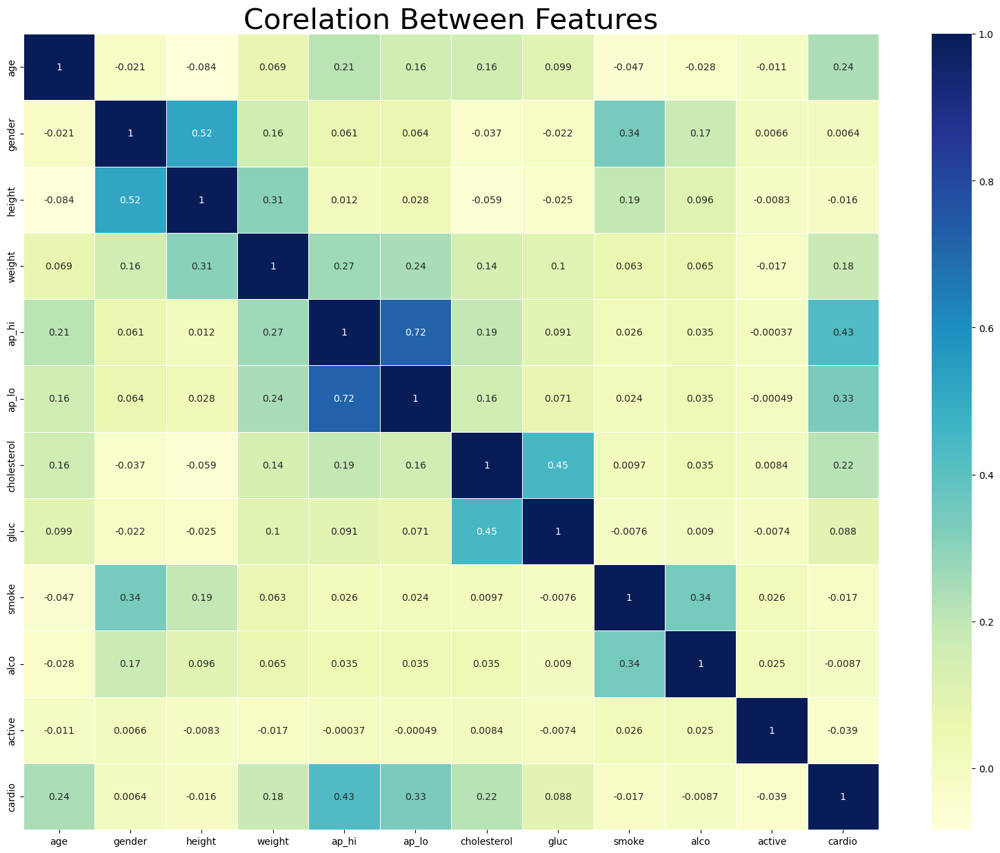

In [58]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (20, 15) 
sns.heatmap(cleaned_data.corr(), annot = True, linewidths=.5, cmap="YlGnBu")
plt.title('Corelation Between Features', fontsize = 30)
plt.savefig("corr heat")
plt.show()


Features with Strong Correlation with Target Value/
- age	0.24
- ap_hi	0.43
- ap_lo	0.33
- cholesterol	0.21
- pulse  0.33

In [59]:
cleaned_data.head()

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,50,2,5.123964,4.127134,110,80,1,1,0,0,1,0
1,55,1,5.049856,4.442651,140,90,3,1,0,0,1,1
2,51,1,5.105945,4.158883,130,70,3,1,0,0,0,1
3,48,2,5.129899,4.406719,150,100,1,1,0,0,1,1
4,47,1,5.049856,4.025352,100,60,1,1,0,0,0,0


In [63]:
X = cleaned_data.drop(['cardio','smoke'], axis =1)

In [64]:
y= cleaned_data['cardio']

In [65]:
X

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,alco,active
0,50,2,5.123964,4.127134,110,80,1,1,0,1
1,55,1,5.049856,4.442651,140,90,3,1,0,1
2,51,1,5.105945,4.158883,130,70,3,1,0,0
3,48,2,5.129899,4.406719,150,100,1,1,0,1
4,47,1,5.049856,4.025352,100,60,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...
67175,57,1,5.105945,4.382027,150,80,1,1,0,1
67176,52,2,5.123964,4.330733,120,80,1,1,0,1
67177,52,2,5.209486,4.653960,180,90,3,1,1,0
67178,61,1,5.093750,4.276666,135,80,1,2,0,0


##### Feature Scaling

In [66]:
scaler = StandardScaler()
standard_X = scaler.fit_transform(X)

In [68]:
X_train, X_test, y_train, y_test = train_test_split(standard_X, y, test_size=0.2, random_state=42, shuffle = True)

In [70]:

#logreg = LogisticRegression(C=1.0, solver='lbfgs', multi_class='ovr')
logreg = LogisticRegression()

In [71]:
logreg.fit(X_train, y_train)
print('Intercept :',logreg.intercept_,'  ','Coeff',logreg.coef_)

Intercept : [0.02316014]    Coeff [[ 0.34561785 -0.02857914 -0.03005105  0.15620497  0.93309361  0.10170874
   0.33592033 -0.06999057 -0.05730855 -0.09057438]]


In [72]:
y_pred = logreg.predict(X_test)
logreg.score(X_test, y_test)

0.7302107379551717

In [73]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.71      0.79      0.75      6781
           1       0.76      0.67      0.71      6648

    accuracy                           0.73     13429
   macro avg       0.73      0.73      0.73     13429
weighted avg       0.73      0.73      0.73     13429



In [74]:
scores = cross_val_score(logreg, X_train, y_train, cv=10)
print('Logistic Model with gives an average accuracy of {0:.2f} % with minimun of {1:.2f} % and maximum of {2:.2f} % accuracy'.format(scores.mean() * 100, scores.min() * 100, scores.max() * 100))

Logistic Model with gives an average accuracy of 72.65 % with minimun of 71.68 % and maximum of 73.67 % accuracy


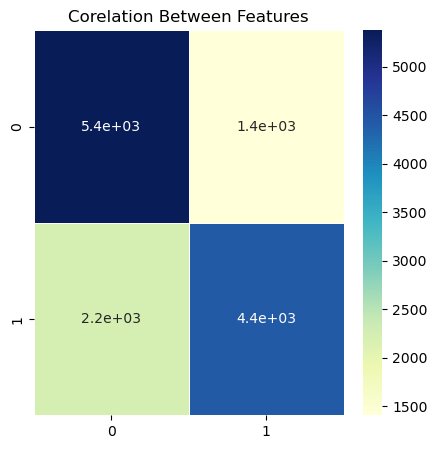

In [76]:
plt.rcParams['figure.figsize'] = (5, 5) 
sns.heatmap(confusion_matrix(y_test, y_pred), annot = True, linewidths=.5, cmap="YlGnBu")
plt.title('Corelation Between Features')
plt.show()

In [79]:
print('True Positive Cases : {}'.format(confusion_matrix(y_test, y_pred)[1][1]))
print('True Negative Cases : {}'.format(confusion_matrix(y_test, y_pred)[0][0]))
print('False Positive Cases : {}'.format(confusion_matrix(y_test, y_pred)[0][1]))
print('False Negative Cases : {}'.format(confusion_matrix(y_test, y_pred)[1][0]))

True Positive Cases : 4429
True Negative Cases : 5377
False Positive Cases : 1404
False Negative Cases : 2219


In [80]:
from sklearn.metrics import classification_report, confusion_matrix, plot_confusion_matrix, roc_curve, roc_auc_score

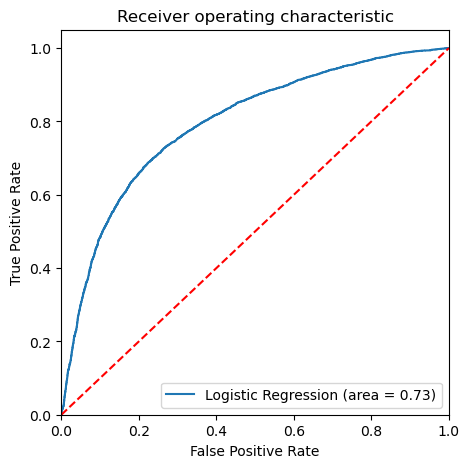

In [81]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
logit_roc_auc = roc_auc_score(y_test, logreg.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, logreg.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

In [82]:
x = np.array([53, 2, 175,85,128,85,2,1,0,1]).reshape(1, -1)
x = StandardScaler().fit_transform(x)
y = logreg.predict(x)
if y==1:
    print('Arthur is more likely to be at risk to get Cardiovascular diseases.')
else:
    print('Arthur does not seem to be at risk to get Cardiovascular diseases.')

Arthur is more likely to be at risk to get Cardiovascular diseases.
